<a href="https://colab.research.google.com/github/ArcaneKnight52/Road-lane-detection/blob/main/road_lane_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import os
os.environ["KAGGLE_CONFIG_DIR"]='/content/gdrive/Mydrive/Kaggle'

In [ ]:
%cd newDataset

[Errno 2] No such file or directory: 'newDataset'
/content


In [ ]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import clear_output, Image, display

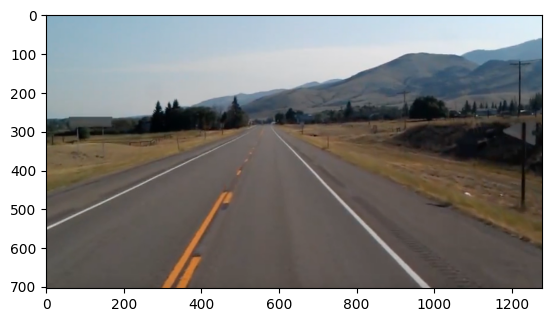

Shape of Image :  (704, 1279, 3)


In [ ]:
image =cv2.cvtColor(cv2.imread("/content/gdrive/MyDrive/Kaggle/newDataset/test_image.jpg"), cv2.COLOR_BGR2RGB) 

plt.imshow(image)
plt.show()
print('Shape of Image : ', image.shape)

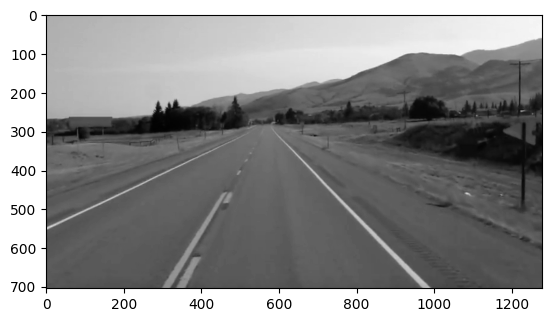

In [ ]:
#RGB to Gray scale
lane_image = np.copy(image)
gray = cv2.cvtColor(lane_image,cv2.COLOR_RGB2GRAY)
plt.imshow(gray, cmap = 'gray')

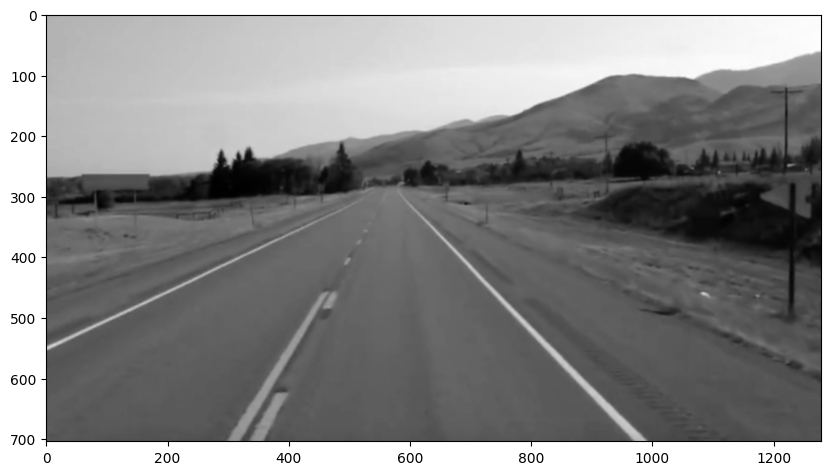

In [ ]:
# Applying gaussian blur for noise reduction and smoothening
blur = cv2.GaussianBlur(gray,(5,5),0)
plt.figure(figsize=(10,10))
#plt.imshow(blur)
plt.imshow(blur,cmap='gray')

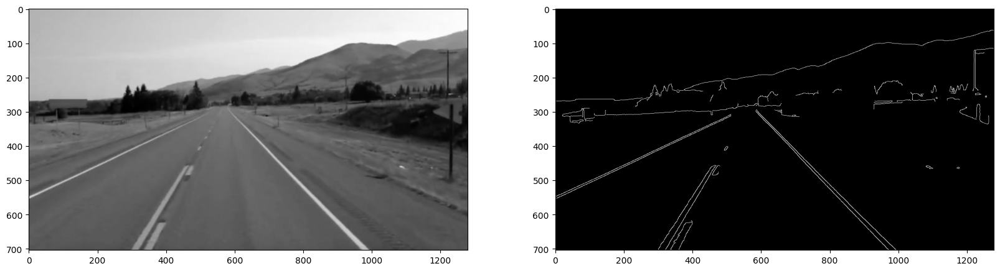

In [ ]:
#Using canny method for edge detection in a image
canny_image = cv2.Canny(blur, 50, 150) # Low to high threshold ratio 1:3.
fig, ax = plt.subplots(1,2,figsize=(20,10))
ax[0].imshow(blur, cmap = 'gray')
ax[1].imshow(canny_image, cmap = 'gray')

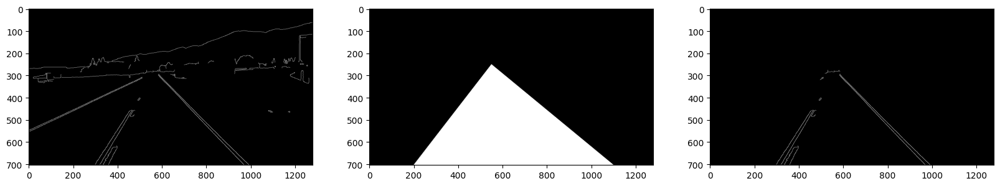

In [ ]:
# to make a function to find region of interest.
def region_of_interest(image):
    height = image.shape[0]
    triangle = np.array([(200, height ), (1100, height), (550, 250)], dtype = np.int32)
    mask = np.zeros_like(image)
    cv2.fillPoly(mask, [triangle], 255)
    return mask
mask = region_of_interest(blur)
cropped_image = canny_image & mask
fig, ax = plt.subplots(1,3,figsize=(20,10))
ax[0].imshow(canny_image, cmap = 'gray')
ax[1].imshow(mask, cmap = 'gray')
ax[2].imshow(cropped_image, cmap = 'gray')

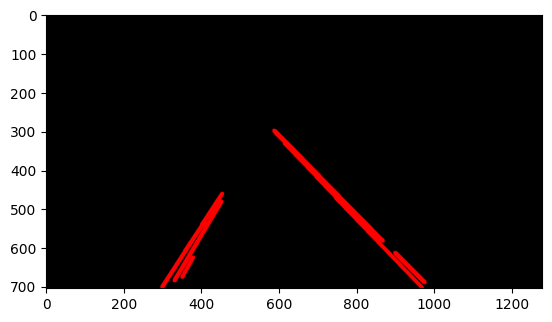

In [ ]:
# Now we can identify the lanes by recognizing line from the region of interest
# We can now find it using Hough transform and by converting cartesian coordinated into hough space
# using the infernce that all points in a line in Cartesian System, will intersect at one point in Hough Space
lines = cv2.HoughLinesP(cropped_image, rho = 2,theta= np.pi/180, threshold = 100, lines = np.array([]),minLineLength = 40, maxLineGap = 5)
def display_line(image, lines):
    lane_image = np.zeros_like(image)
    for line in lines:
        x1, y1, x2, y2 = line.reshape(4)
        cv2.line(lane_image, (x1, y1), (x2, y2), (255, 0, 0), 10)
    return lane_image
line_image = display_line(lane_image, lines)
plt.imshow(line_image)

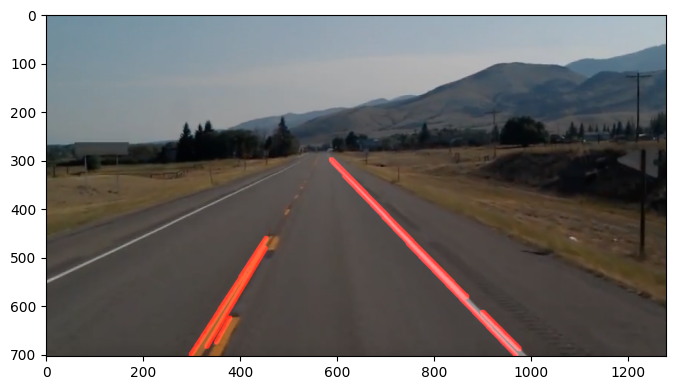

In [ ]:
#now we can combine the above immage containing just the lines in a black image superimposed on  our original image
combo_image = cv2.addWeighted(lane_image, 0.8, line_image, 1, 1)
plt.figure(figsize = (8,10))
plt.imshow(combo_image)

In [ ]:
# We can now optimize the Lines and convert multiple line as a single one to refine the detection of lanes
# this is done by calling in the coordinates and determining best fit and approximating using slopes and intercepts of the respective lines
def make_coordinates(image, line_params):
    slope, intercept = line_params
    y1 = image.shape[0] # image bottom
    y2 = int(y1*0.5)
    x1 = int((y1 - intercept)/slope) # y = m*x + c
    x2 = int((y2 - intercept)/slope)
    return np.array([x1,y1,x2,y2])
def average_line(image, lines):
    ''' determine best fit lines'''
    left_fit = []
    right_fit = []
    for line in lines:
        x1, y1, x2, y2 = line.reshape(4)
        parameters = np.polyfit((x1, x2), (y1, y2), 1) 
        slope = parameters[0]
        intercept = parameters[1]
        if slope < 0:
            left_fit.append((slope, intercept))
        else:
            right_fit.append((slope, intercept))
    left_fit_avg = np.average(left_fit, axis = 0)
    right_fit_avg = np.average(right_fit, axis = 0)
    left_line = make_coordinates(image, left_fit_avg)
    right_line = make_coordinates(image, right_fit_avg)
    print('Left',left_fit_avg )
    print('Right',right_fit_avg )
    return np.array([left_line,right_line])
    
avg_lines = average_line(lane_image, lines)

Left [  -1.60834719 1201.39747201]
Right [   1.0101573  -291.07947816]


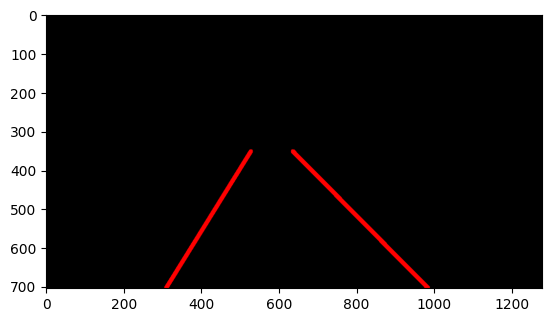

In [ ]:
line_image= display_line(lane_image, avg_lines)
plt.imshow(line_image)

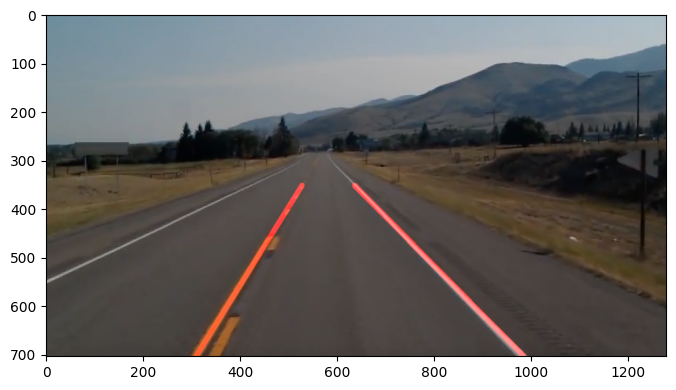

In [ ]:
#combining the image
combo_image = cv2.addWeighted(lane_image, 0.8, line_image, 1, 1) 
plt.figure(figsize = (8,10))
plt.imshow(combo_image)

Frame No. [[[189 163 129]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 213]
  [253 234 213]
  [253 234 213]]

 [[189 163 129]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 213]
  [253 234 213]
  [253 234 213]]

 [[189 163 129]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 213]
  [253 234 213]
  [253 234 213]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]]

 [[ 62  68  72]
  [ 62  68  72]
  [ 62  68  72]
  ...
  [ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]]

 [[ 62  68  72]
  [ 62  68  72]
  [ 62  68  72]
  ...
  [ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]]]
Left [  -1.87340799 1356.76218709]
Right [   0.96951501 -269.81509634]


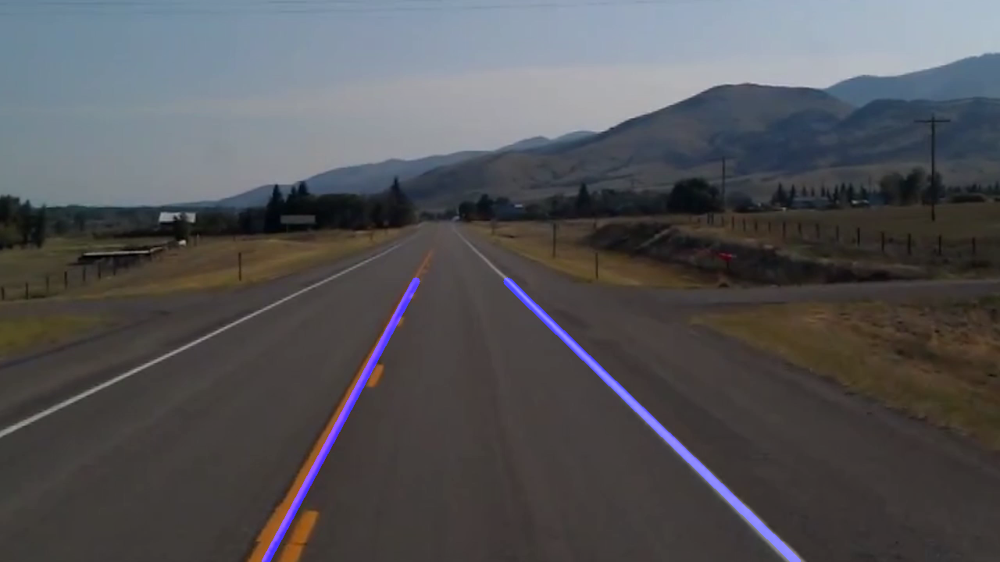

Frame No. [[[189 163 129]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 213]
  [253 234 213]
  [253 234 213]]

 [[189 163 129]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 213]
  [253 234 213]
  [253 234 213]]

 [[189 163 129]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 213]
  [253 234 213]
  [253 234 213]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]]

 [[ 62  68  72]
  [ 62  68  72]
  [ 62  68  72]
  ...
  [ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]]

 [[ 62  68  72]
  [ 62  68  72]
  [ 62  68  72]
  ...
  [ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]]]
Left [  -1.88435374 1359.94557823]
Right [   0.97471477 -275.61410206]


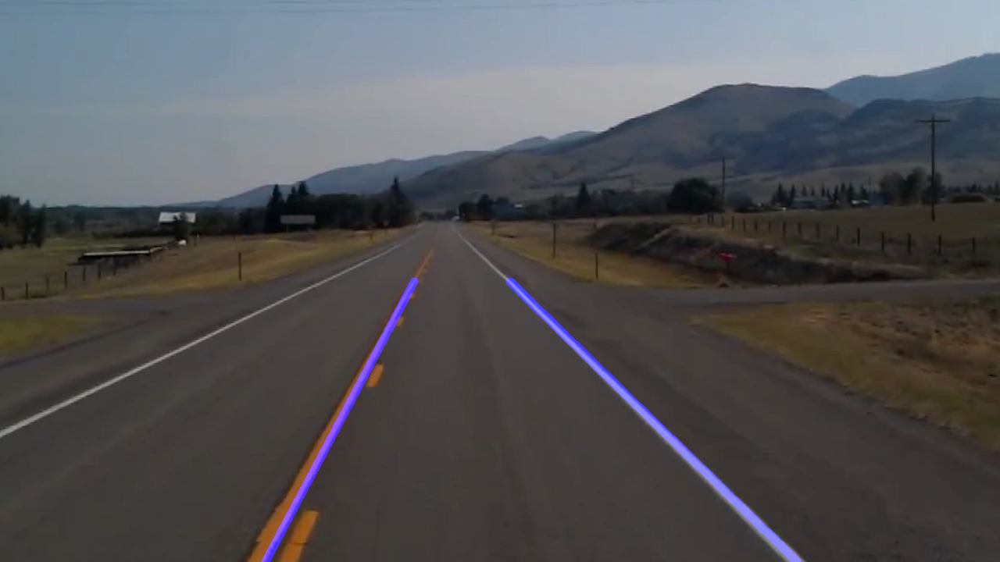

Frame No. [[[184 161 126]
  [184 161 126]
  [184 161 126]
  ...
  [255 234 215]
  [255 234 215]
  [255 234 215]]

 [[184 161 126]
  [184 161 126]
  [184 161 126]
  ...
  [255 234 215]
  [255 234 215]
  [255 234 215]]

 [[186 163 128]
  [186 163 128]
  [186 163 128]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 ...

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.78200297 1302.18676705]
Right [   0.96642222 -266.58775585]


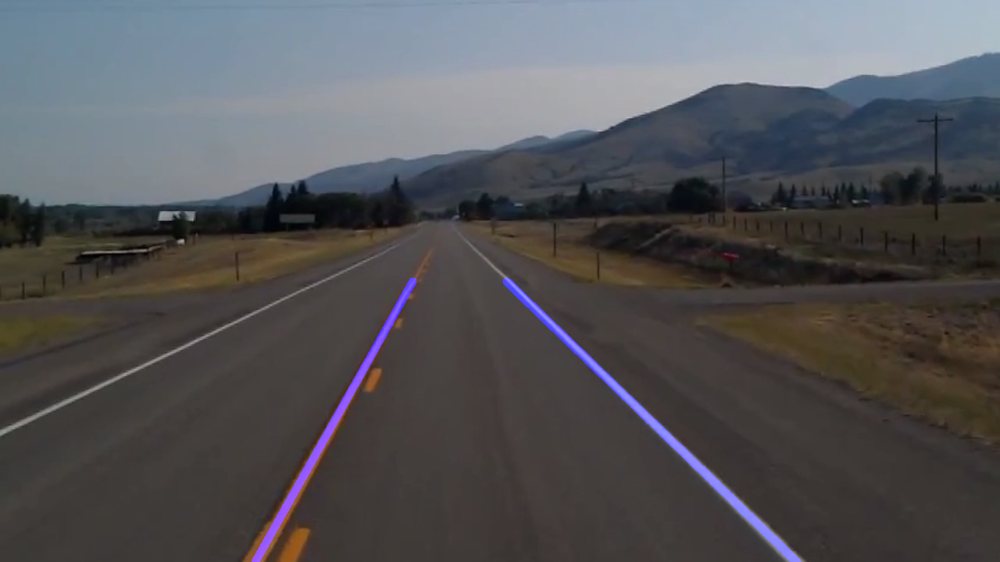

Frame No. [[[184 161 126]
  [184 161 126]
  [184 161 126]
  ...
  [255 234 215]
  [255 234 215]
  [255 234 215]]

 [[184 161 126]
  [184 161 126]
  [184 161 126]
  ...
  [255 234 215]
  [255 234 215]
  [255 234 215]]

 [[186 163 128]
  [186 163 128]
  [186 163 128]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 ...

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.78200297 1302.18676705]
Right [   0.96642222 -266.58775585]


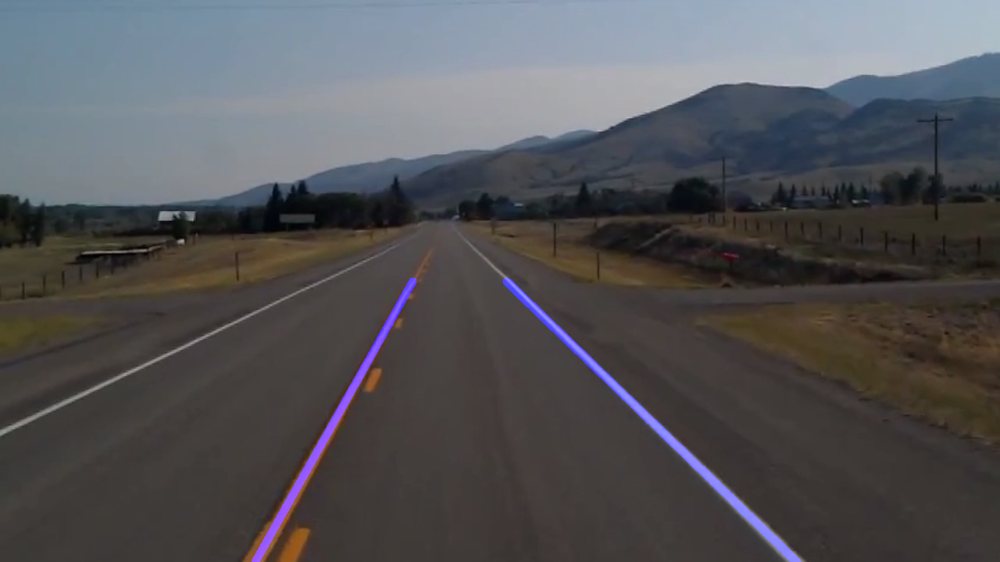

Frame No. [[[192 165 129]
  [192 165 129]
  [192 165 129]
  ...
  [254 233 214]
  [254 233 214]
  [254 233 214]]

 [[192 165 129]
  [192 165 129]
  [192 165 129]
  ...
  [254 233 214]
  [254 233 214]
  [254 233 214]]

 [[191 164 128]
  [191 164 128]
  [191 164 128]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 ...

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]]]
Left [  -1.88206973 1356.38840181]
Right [   0.97484009 -274.8739918 ]


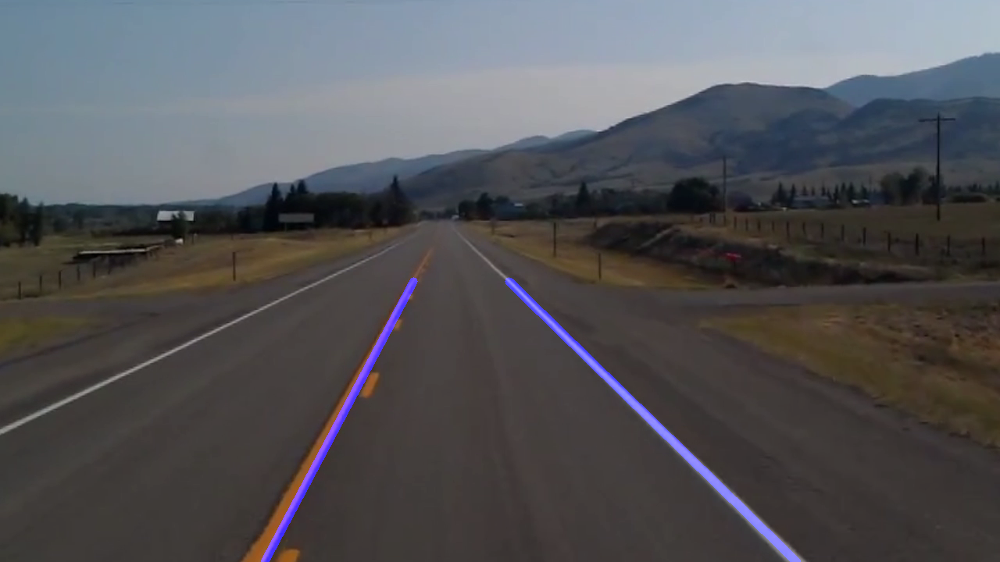

Frame No. [[[186 160 126]
  [186 160 126]
  [186 160 126]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 [[188 162 128]
  [188 162 128]
  [188 162 128]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 [[190 164 130]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 215]
  [253 233 216]
  [253 233 216]]

 ...

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 64  66  73]
  [ 64  66  73]
  [ 64  66  73]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 64  66  73]
  [ 64  66  73]
  [ 64  66  73]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 64  66  73]
  [ 64  66  73]
  [ 64  66  73]]]
Left [  -1.77854887 1294.98519468]
Right [   0.97063712 -271.84389211]


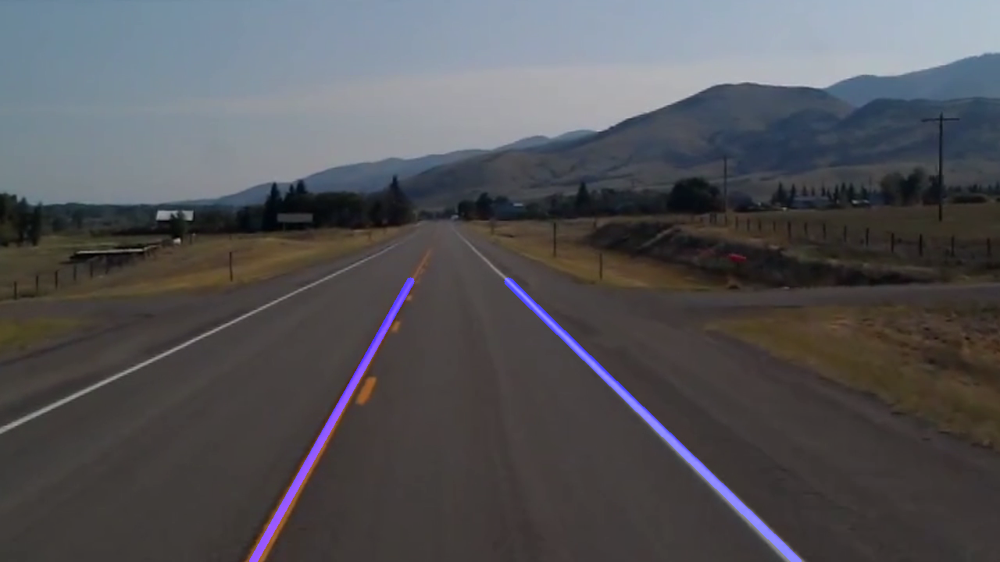

Frame No. [[[186 160 126]
  [186 160 126]
  [186 160 126]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 [[188 162 128]
  [188 162 128]
  [188 162 128]
  ...
  [253 234 215]
  [253 234 215]
  [253 234 215]]

 [[190 164 130]
  [189 163 129]
  [189 163 129]
  ...
  [253 234 215]
  [253 233 216]
  [253 233 216]]

 ...

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 64  66  73]
  [ 64  66  73]
  [ 64  66  73]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 64  66  73]
  [ 64  66  73]
  [ 64  66  73]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 64  66  73]
  [ 64  66  73]
  [ 64  66  73]]]
Left [  -1.77854887 1294.98519468]
Right [   0.97063712 -271.84389211]


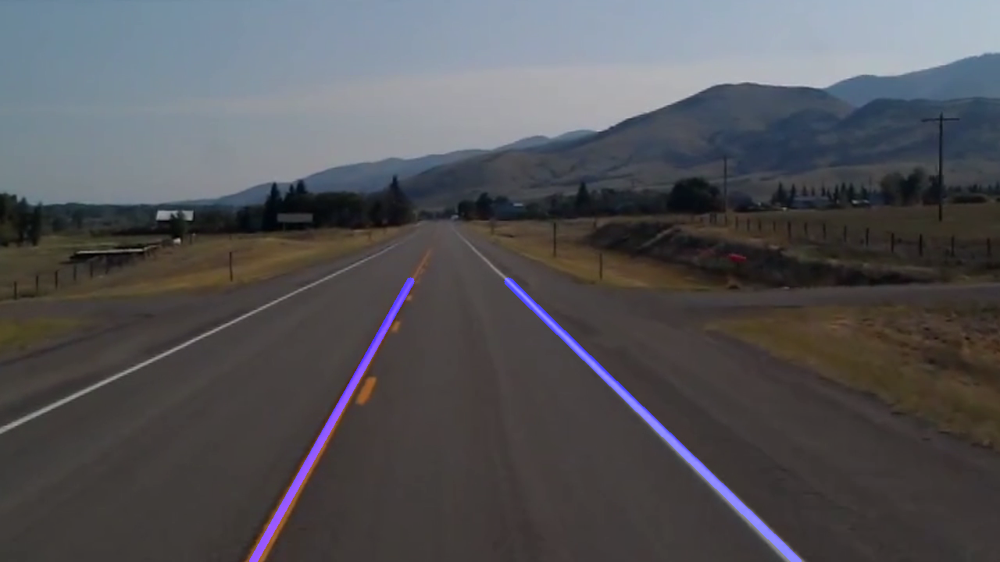

Frame No. [[[189 163 131]
  [189 163 131]
  [189 163 131]
  ...
  [249 235 213]
  [249 235 213]
  [249 235 213]]

 [[189 163 131]
  [189 163 131]
  [189 163 131]
  ...
  [249 235 213]
  [249 235 213]
  [249 235 213]]

 [[187 164 131]
  [187 164 131]
  [187 164 131]
  ...
  [247 235 213]
  [247 235 213]
  [247 235 213]]

 ...

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 66  68  75]
  [ 66  68  75]
  [ 66  68  75]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 66  68  75]
  [ 66  68  75]
  [ 66  68  75]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]]
Left [  -1.76630363 1292.859795  ]
Right [   0.97041079 -269.91937796]


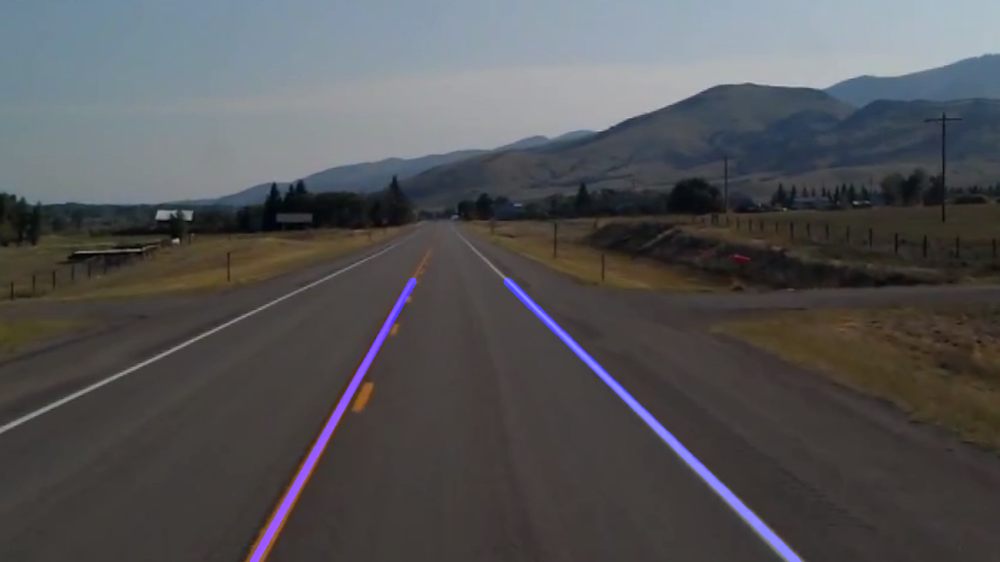

Frame No. [[[189 163 131]
  [189 163 131]
  [189 163 131]
  ...
  [249 235 213]
  [249 235 213]
  [249 235 213]]

 [[189 163 131]
  [189 163 131]
  [189 163 131]
  ...
  [249 235 213]
  [249 235 213]
  [249 235 213]]

 [[187 164 131]
  [187 164 131]
  [187 164 131]
  ...
  [247 235 213]
  [247 235 213]
  [247 235 213]]

 ...

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 66  68  75]
  [ 66  68  75]
  [ 66  68  75]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 66  68  75]
  [ 66  68  75]
  [ 66  68  75]]

 [[ 62  69  70]
  [ 62  69  70]
  [ 62  69  70]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]]
Left [  -1.76630363 1292.859795  ]
Right [   0.97041079 -269.91937796]


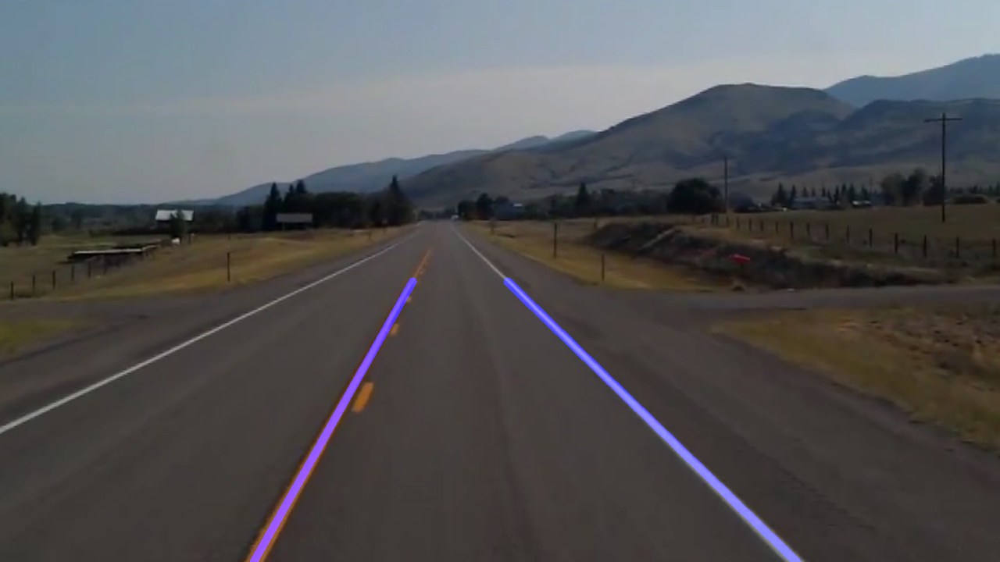

Frame No. [[[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 ...

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]]
Left [  -1.87712447 1351.57067535]
Right [   0.98154688 -274.37885807]


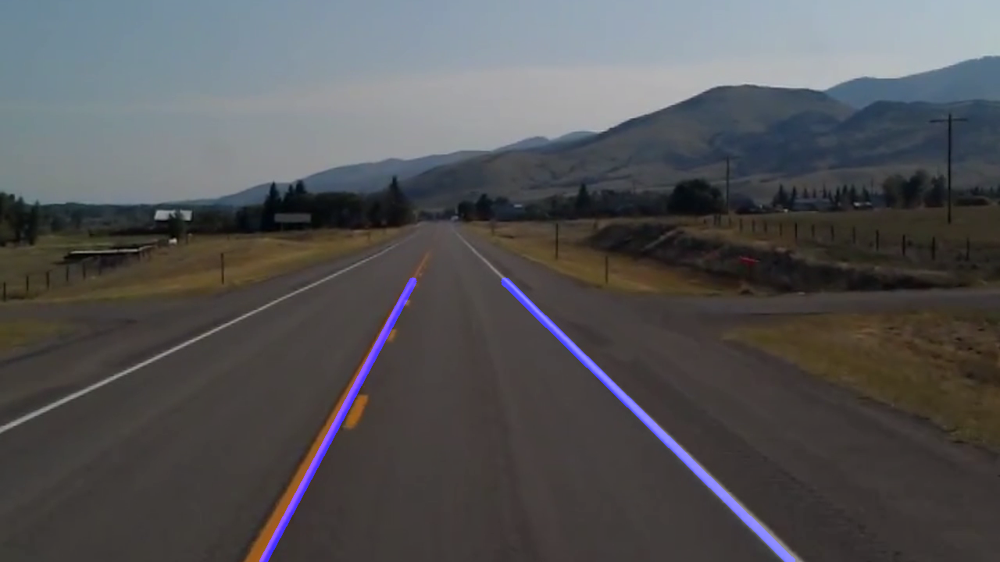

Frame No. [[[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 ...

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]]
Left [  -1.87712447 1351.57067535]
Right [   0.98154688 -274.37885807]


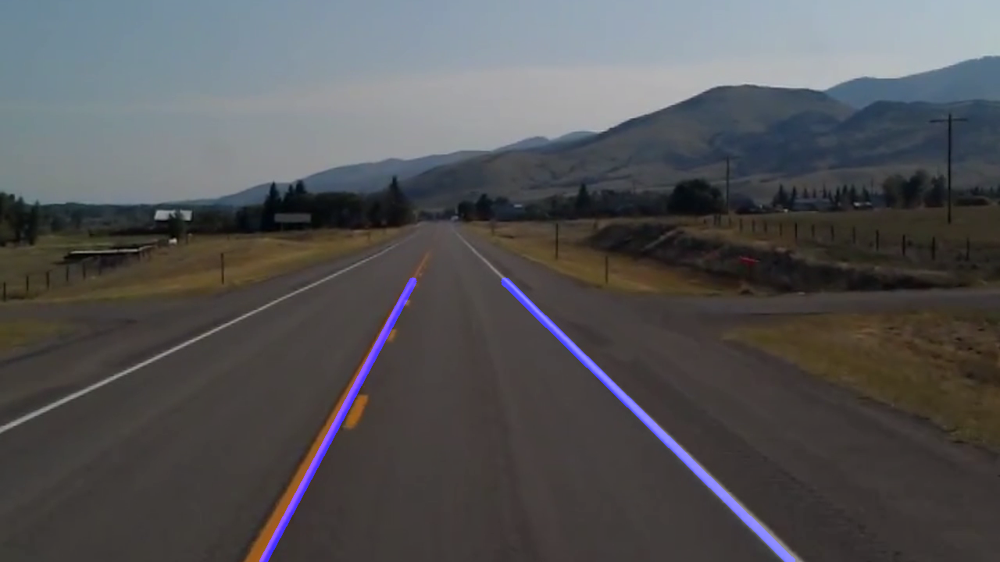

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 ...

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 68  70  77]
  [ 68  70  77]
  [ 68  70  77]]

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  71  72]
  [ 64  71  72]
  [ 64  71  72]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]]
Left [  -1.87413206 1349.75890004]
Right [   0.97164537 -268.29866335]


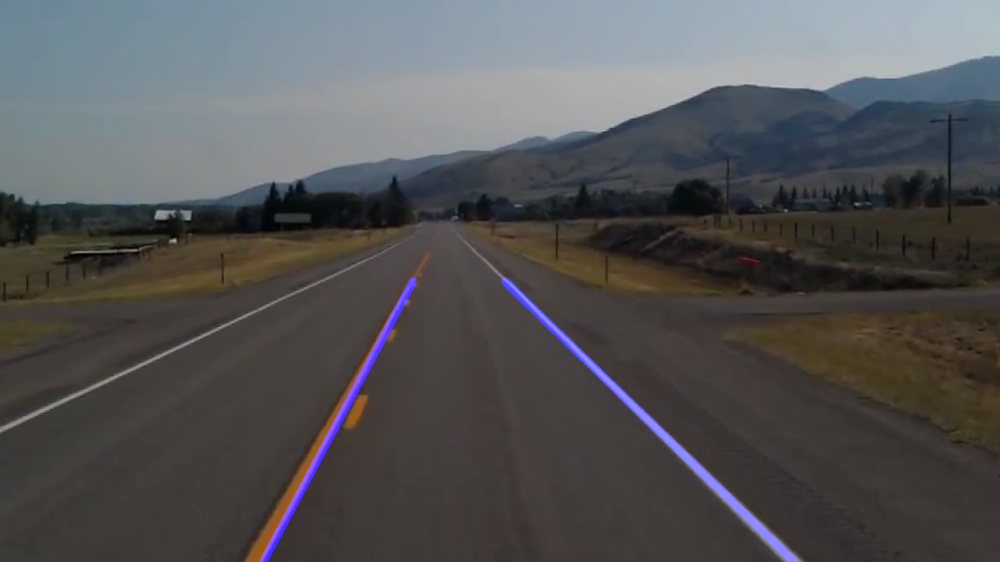

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 ...

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 66  71  77]
  [ 66  71  77]
  [ 66  71  77]]

 [[ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]
  ...
  [ 66  70  79]
  [ 66  70  79]
  [ 66  70  79]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 66  70  79]
  [ 66  70  79]
  [ 66  70  79]]]
Left [  -1.88740322 1355.0395802 ]
Right [   0.9793419 -272.5943296]


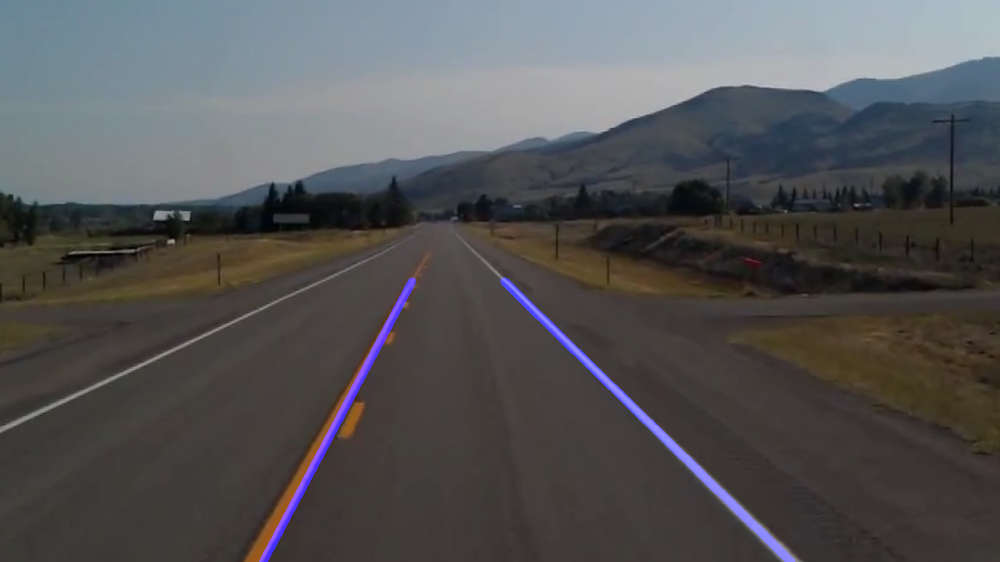

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 ...

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 66  71  77]
  [ 66  71  77]
  [ 66  71  77]]

 [[ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]
  ...
  [ 66  70  79]
  [ 66  70  79]
  [ 66  70  79]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 66  70  79]
  [ 66  70  79]
  [ 66  70  79]]]
Left [  -1.88740322 1355.0395802 ]
Right [   0.9793419 -272.5943296]


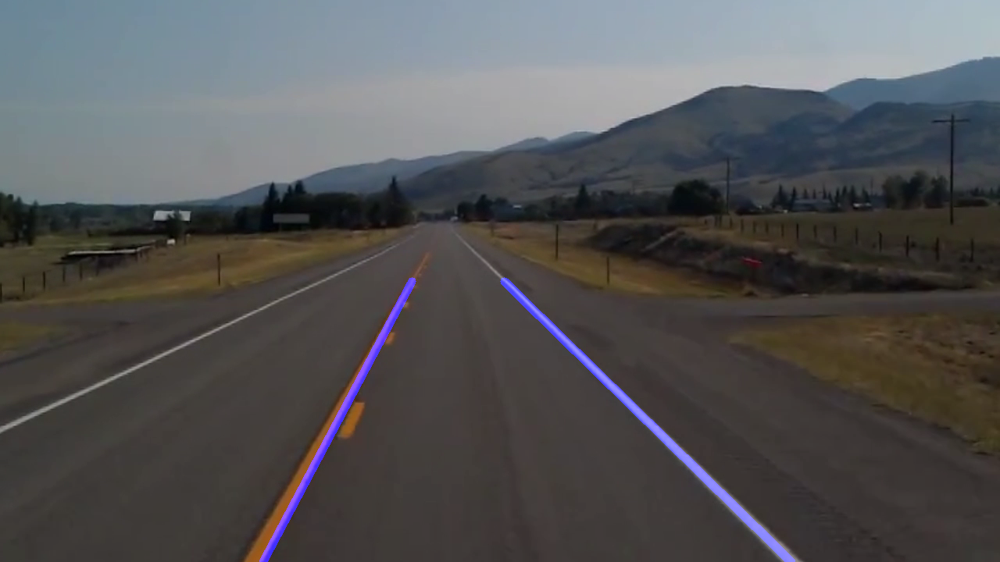

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 212]
  [248 234 212]
  [248 234 212]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 212]
  [248 234 212]
  [248 234 212]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [248 234 212]
  [248 234 212]
  [248 234 212]]

 ...

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 66  68  75]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 66  68  75]
  [ 66  68  75]
  [ 66  68  75]]]
Left [  -1.73671781 1274.75105637]
Right [   0.97601429 -268.29572539]


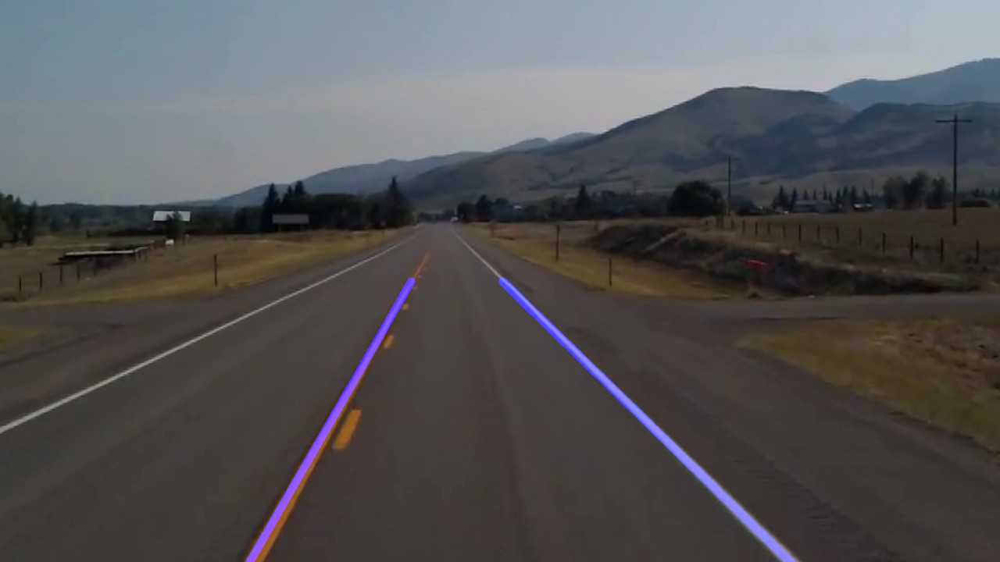

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 212]
  [248 234 212]
  [248 234 212]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 212]
  [248 234 212]
  [248 234 212]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [248 234 212]
  [248 234 212]
  [248 234 212]]

 ...

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 66  68  75]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 66  68  75]
  [ 66  68  75]
  [ 66  68  75]]]
Left [  -1.73671781 1274.75105637]
Right [   0.97601429 -268.29572539]


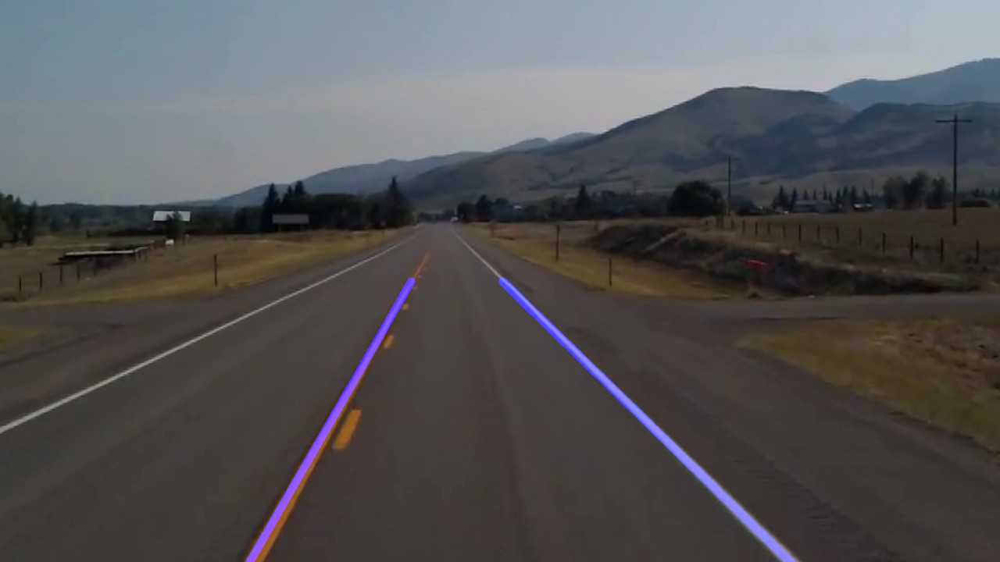

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [246 234 214]
  [246 234 214]
  [246 234 214]]

 ...

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 68  71  76]
  [ 68  71  76]
  [ 67  70  75]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 68  71  76]
  [ 68  71  76]
  [ 67  70  75]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 68  71  76]
  [ 68  71  76]
  [ 67  70  75]]]
Left [  -1.87567568 1351.1027027 ]
Right [   0.98182399 -272.36760166]


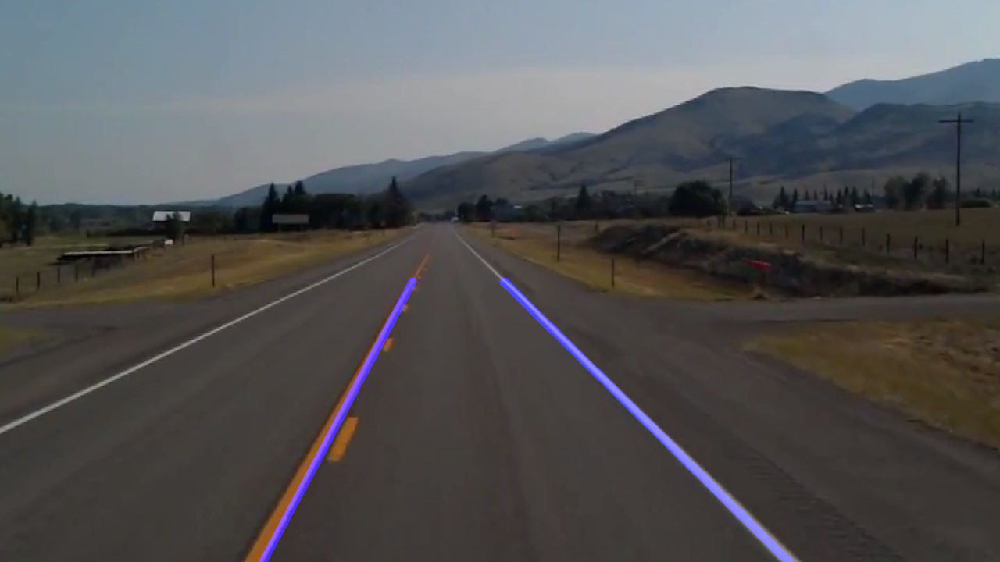

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [246 234 214]
  [246 234 214]
  [246 234 214]]

 ...

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 68  71  76]
  [ 68  71  76]
  [ 67  70  75]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 68  71  76]
  [ 68  71  76]
  [ 67  70  75]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 68  71  76]
  [ 68  71  76]
  [ 67  70  75]]]
Left [  -1.87567568 1351.1027027 ]
Right [   0.98333419 -274.83933878]


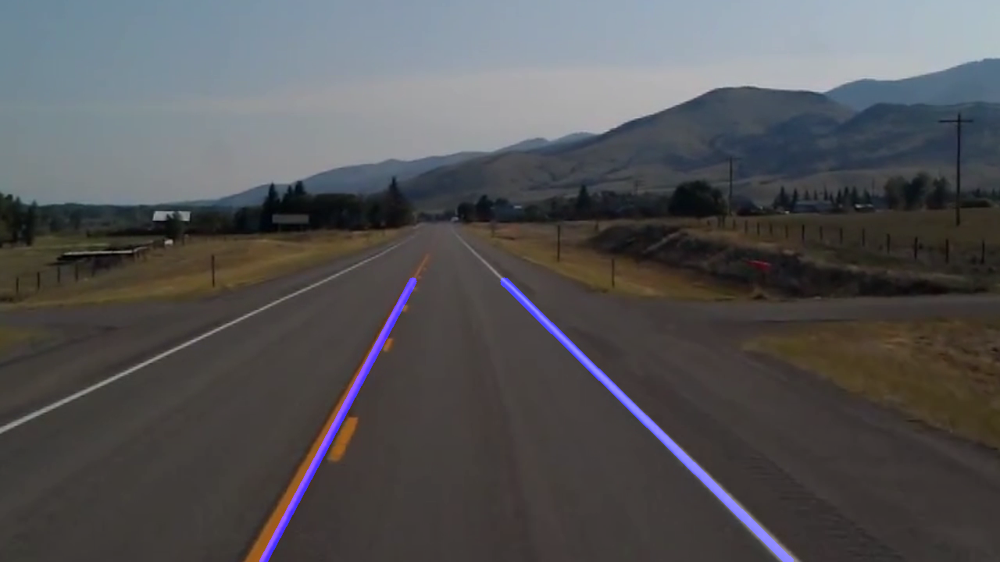

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [249 233 213]
  [249 233 213]
  [249 233 213]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [249 233 213]
  [249 233 213]
  [249 233 213]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.88116197 1348.50176056]
Right [   0.99159498 -280.46130842]


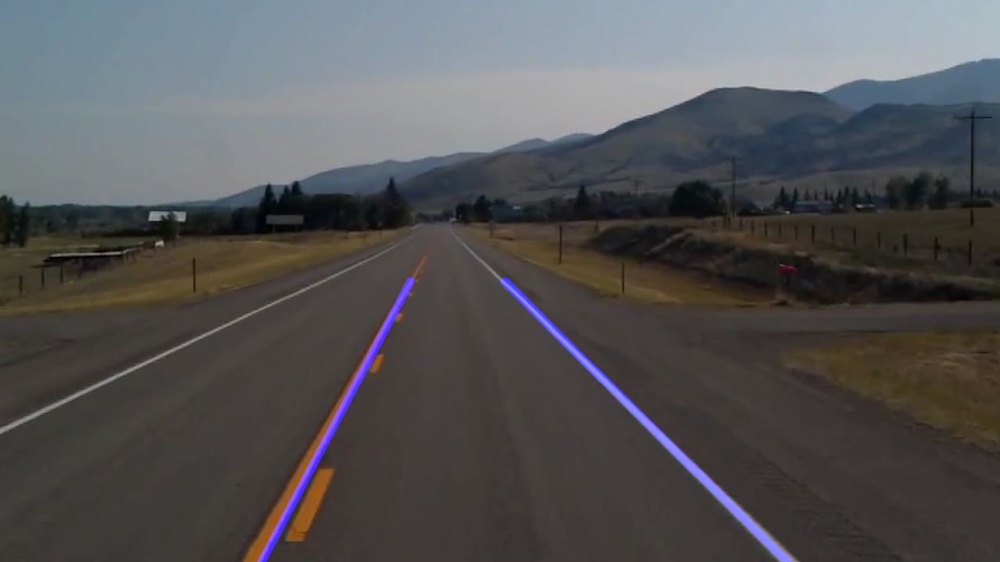

Frame No. [[[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [249 233 213]
  [249 233 213]
  [249 233 213]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [249 233 213]
  [249 233 213]
  [249 233 213]]

 [[186 165 130]
  [186 165 130]
  [186 165 130]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.88116197 1348.50176056]
Right [   0.99159498 -280.46130842]


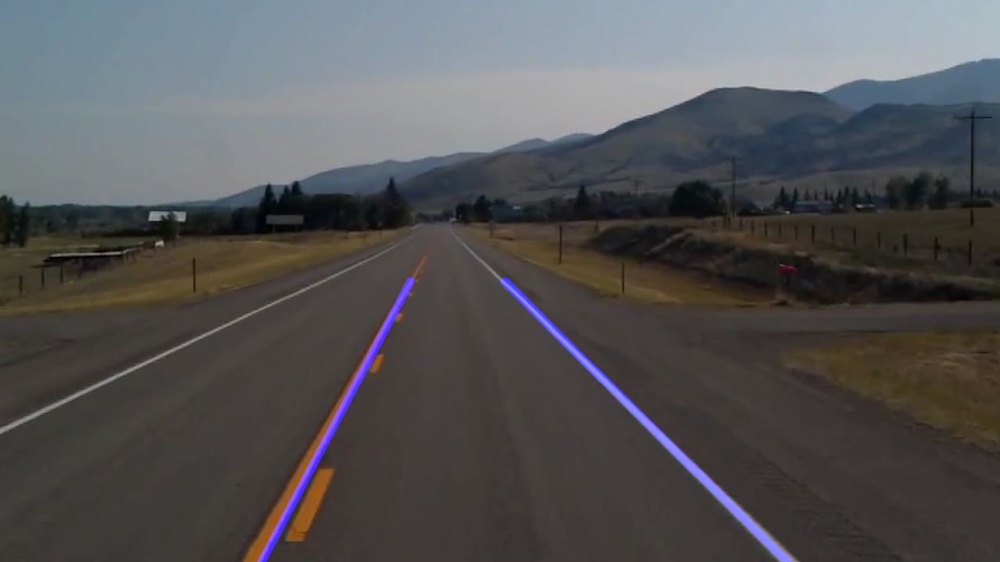

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.86186594 1340.3120471 ]
Right [   0.98476994 -271.45455971]


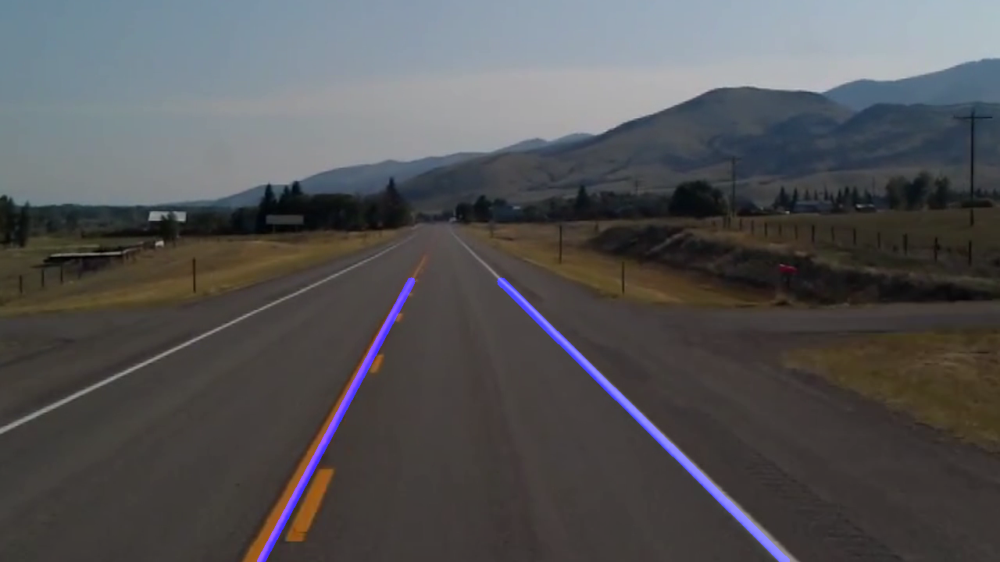

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.86156616 1341.0139858 ]
Right [   0.98173418 -270.48866093]


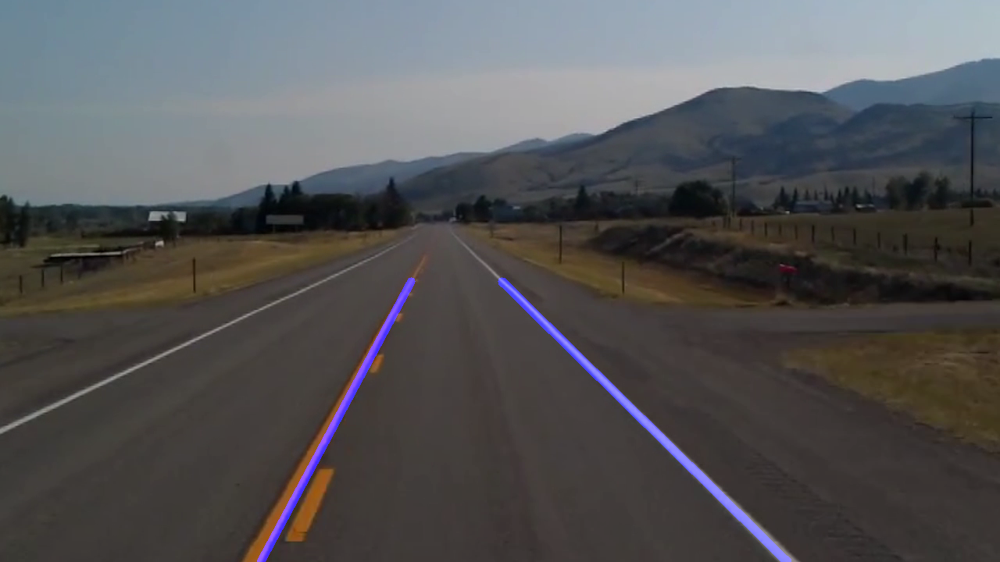

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.88235294 1349.58823529]
Right [   0.99308017 -279.65450374]


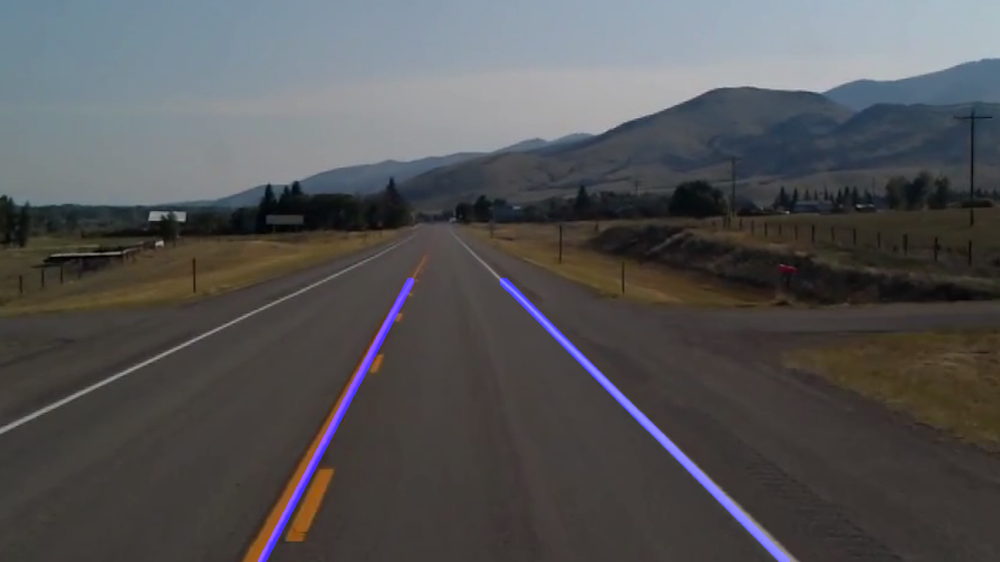

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.88235294 1349.58823529]
Right [   0.98020286 -270.55241535]


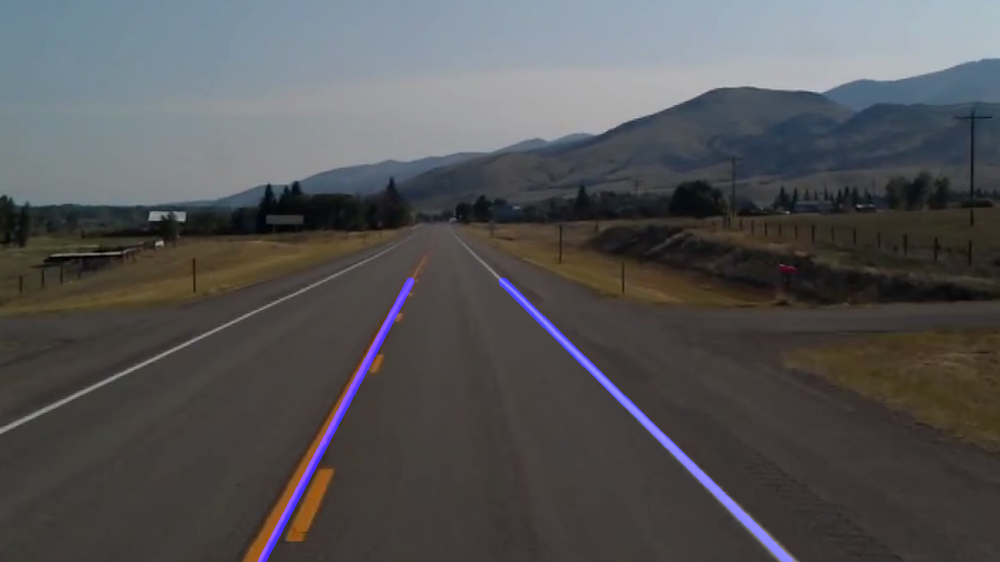

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.83640805 1330.62308929]
Right [   0.98469679 -272.08788866]


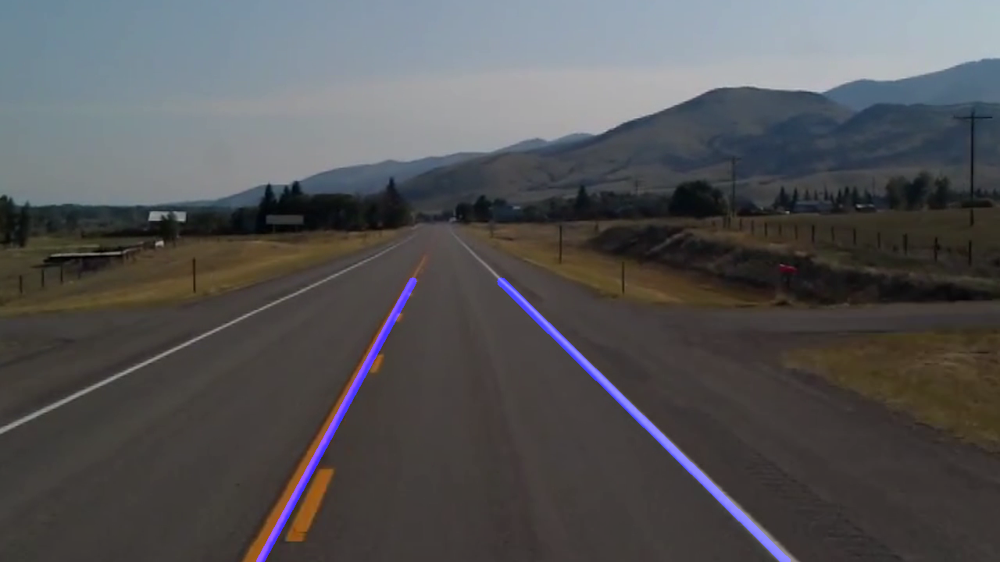

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.8757764  1346.39751553]
Right [   0.96845084 -261.77801533]


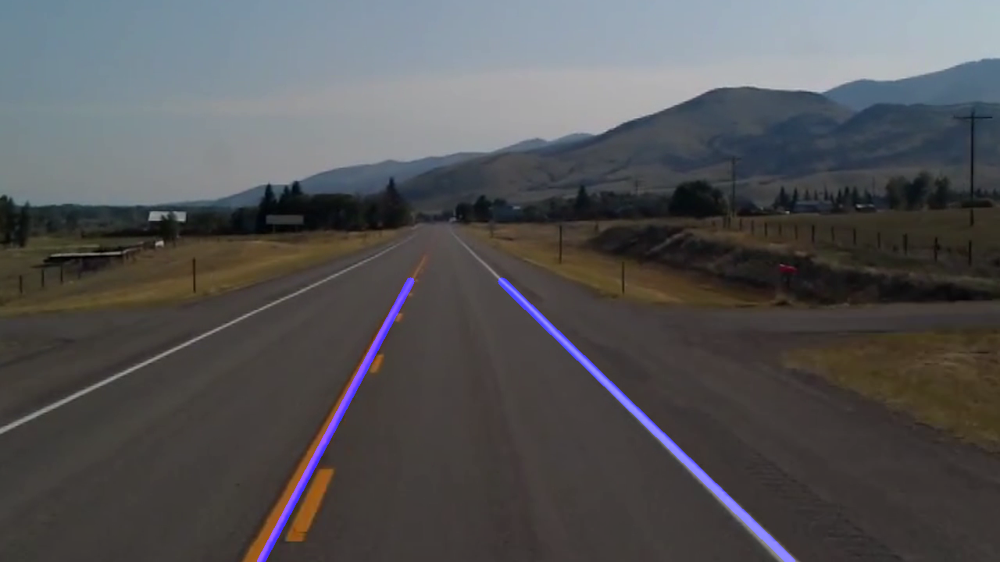

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 62  65  70]
  [ 62  65  70]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]]
Left [  -1.8757764  1346.39751553]
Right [   0.96845084 -261.77801533]


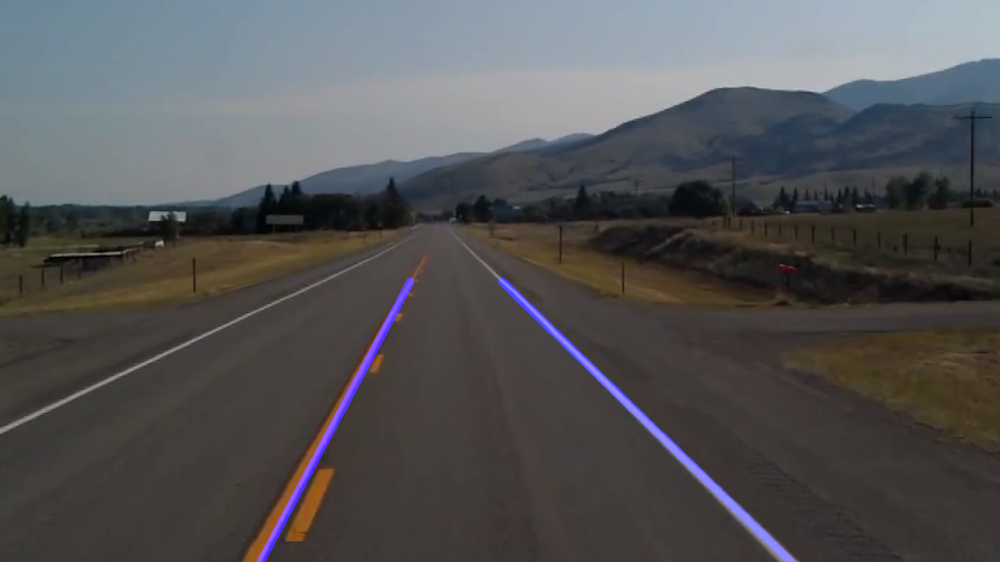

Frame No. [[[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [250 234 214]
  [250 234 214]
  [250 234 214]]

 [[186 166 129]
  [186 166 129]
  [186 166 129]
  ...
  [248 234 214]
  [248 234 214]
  [248 234 214]]

 ...

 [[ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]
  ...
  [ 61  62  72]
  [ 61  62  72]
  [ 61  62  72]]

 [[ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]
  ...
  [ 61  62  72]
  [ 61  62  72]
  [ 61  62  72]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 61  62  72]
  [ 61  62  72]
  [ 61  62  72]]]
Left [  -1.87616776 1347.91790896]
Right [   0.98745726 -272.67423077]


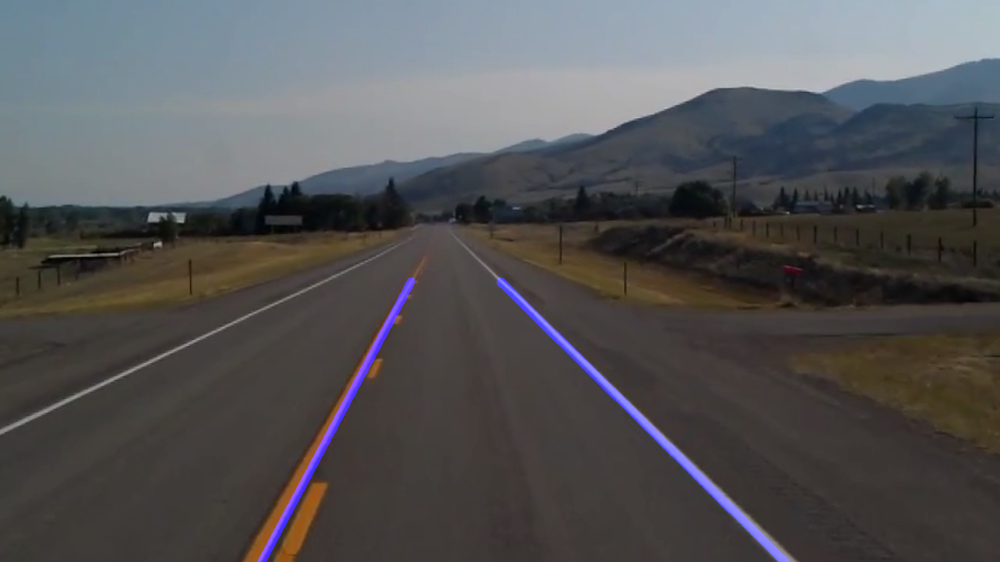

Frame No. [[[190 165 129]
  [190 165 129]
  [190 165 129]
  ...
  [255 232 214]
  [255 232 214]
  [255 232 214]]

 [[190 165 129]
  [190 165 129]
  [190 165 129]
  ...
  [255 232 214]
  [255 232 214]
  [255 232 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [255 232 214]
  [255 232 214]
  [255 232 214]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  70  77]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 69  71  78]
  [ 68  70  77]
  [ 67  69  76]]]
Left [  -1.7220325 1262.5990804]
Right [   0.99325889 -275.49641094]


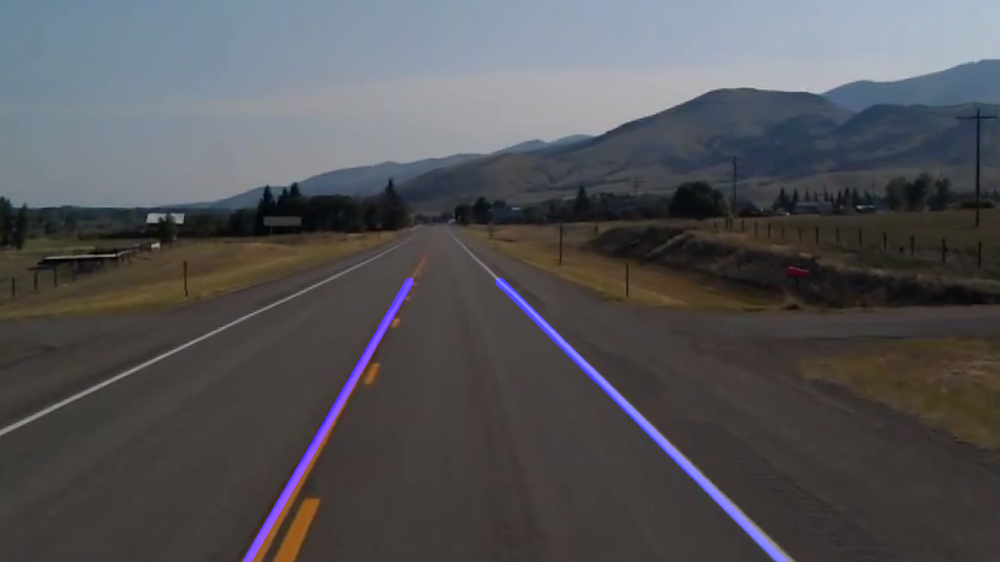

Frame No. [[[190 165 129]
  [190 165 129]
  [190 165 129]
  ...
  [255 232 214]
  [255 232 214]
  [255 232 214]]

 [[190 165 129]
  [190 165 129]
  [190 165 129]
  ...
  [255 232 214]
  [255 232 214]
  [255 232 214]]

 [[188 166 129]
  [188 166 129]
  [188 166 129]
  ...
  [255 232 214]
  [255 232 214]
  [255 232 214]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  70  77]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 69  71  78]
  [ 68  70  77]
  [ 67  69  76]]]
Left [  -1.73774555 1271.82140564]
Right [   0.99434256 -278.69586642]


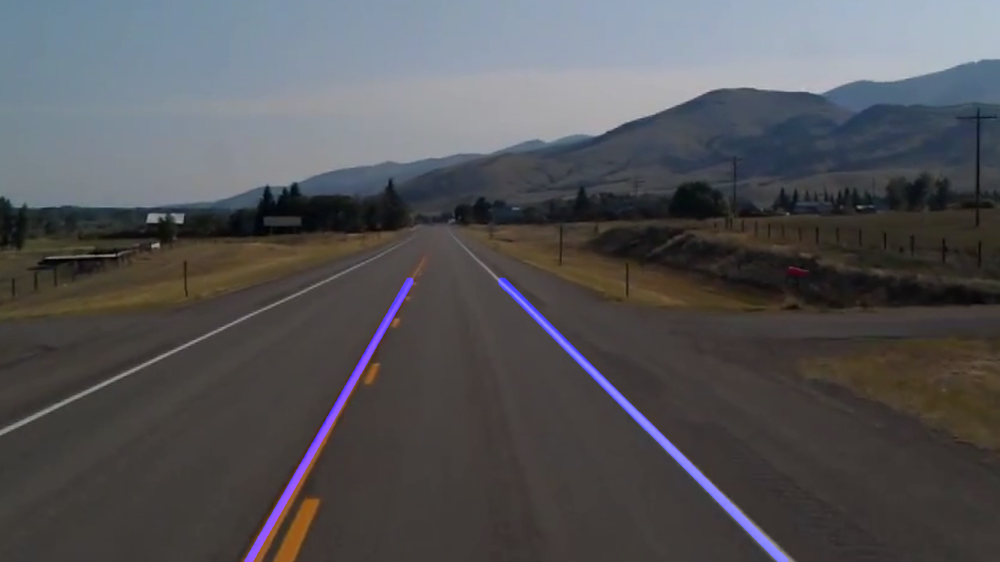

Frame No. [[[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [255 232 212]
  [255 232 212]
  [255 232 212]]

 [[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [255 232 212]
  [255 232 212]
  [255 232 212]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [255 232 212]
  [255 232 212]
  [255 232 212]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  68  75]
  [ 68  68  75]
  [ 68  68  75]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  68  75]
  [ 68  68  75]
  [ 68  68  75]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  68  75]
  [ 68  68  75]
  [ 68  68  75]]]
Left [  -1.71999383 1262.45370088]
Right [   0.9737771  -261.91498038]


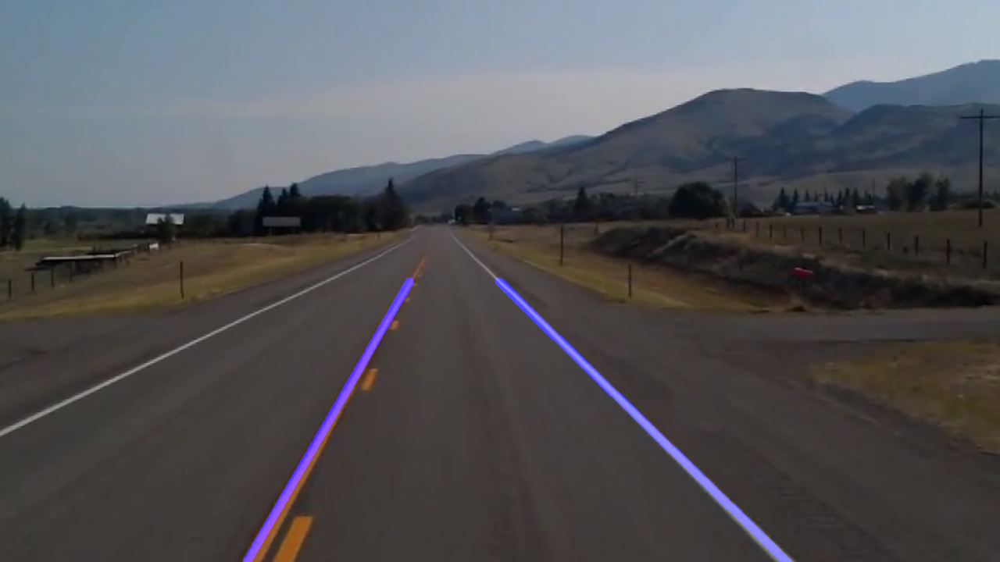

Frame No. [[[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [255 232 212]
  [255 232 212]
  [255 232 212]]

 [[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [255 232 212]
  [255 232 212]
  [255 232 212]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [255 232 212]
  [255 232 212]
  [255 232 212]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  68  75]
  [ 68  68  75]
  [ 68  68  75]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  68  75]
  [ 68  68  75]
  [ 68  68  75]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 68  68  75]
  [ 68  68  75]
  [ 68  68  75]]]
Left [  -1.71999383 1262.45370088]
Right [   0.9737771  -261.91498038]


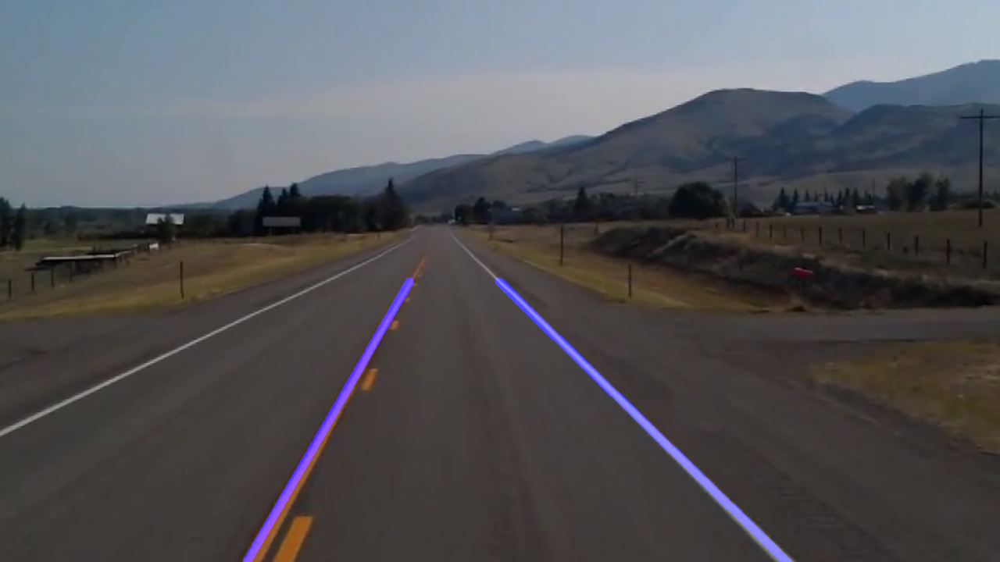

Frame No. [[[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [254 234 210]
  [254 234 210]
  [254 234 210]]

 [[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [254 234 210]
  [254 234 210]
  [254 234 210]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [255 234 213]
  [255 234 213]
  [255 234 213]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 62  65  70]
  [ 62  65  70]
  [ 62  65  70]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 62  65  70]
  [ 62  65  70]
  [ 62  65  70]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 62  65  70]
  [ 62  65  70]
  [ 62  65  70]]]
Left [  -1.71342179 1258.66121655]
Right [   0.98066645 -265.14238557]


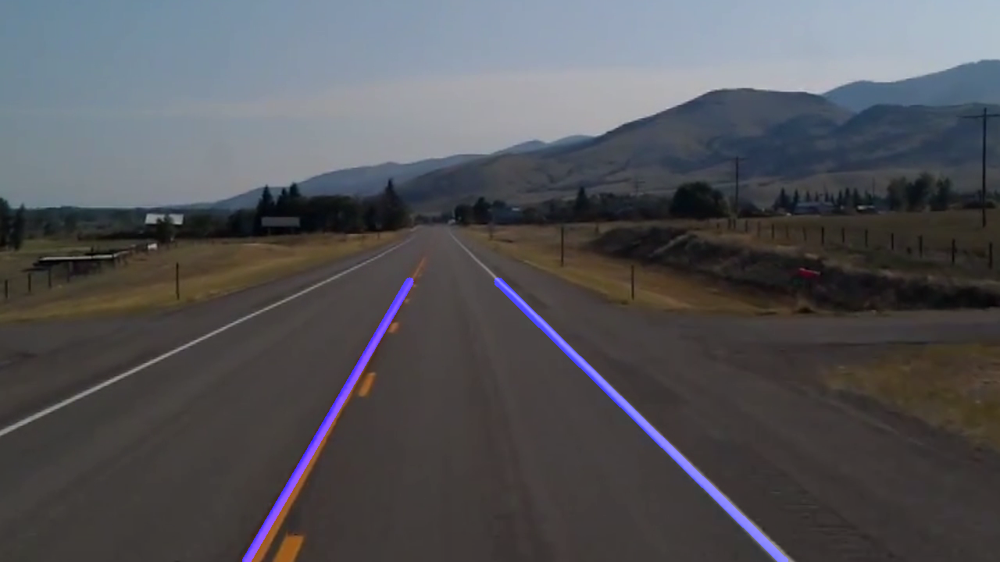

Frame No. [[[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [254 234 210]
  [254 234 210]
  [254 234 210]]

 [[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [254 234 210]
  [254 234 210]
  [254 234 210]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [255 234 213]
  [255 234 213]
  [255 234 213]]

 ...

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 62  65  70]
  [ 62  65  70]
  [ 62  65  70]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 62  65  70]
  [ 62  65  70]
  [ 62  65  70]]

 [[ 64  70  74]
  [ 64  70  74]
  [ 64  70  74]
  ...
  [ 62  65  70]
  [ 62  65  70]
  [ 62  65  70]]]
Left [  -1.70846528 1255.88441366]
Right [   0.97736345 -262.99884025]


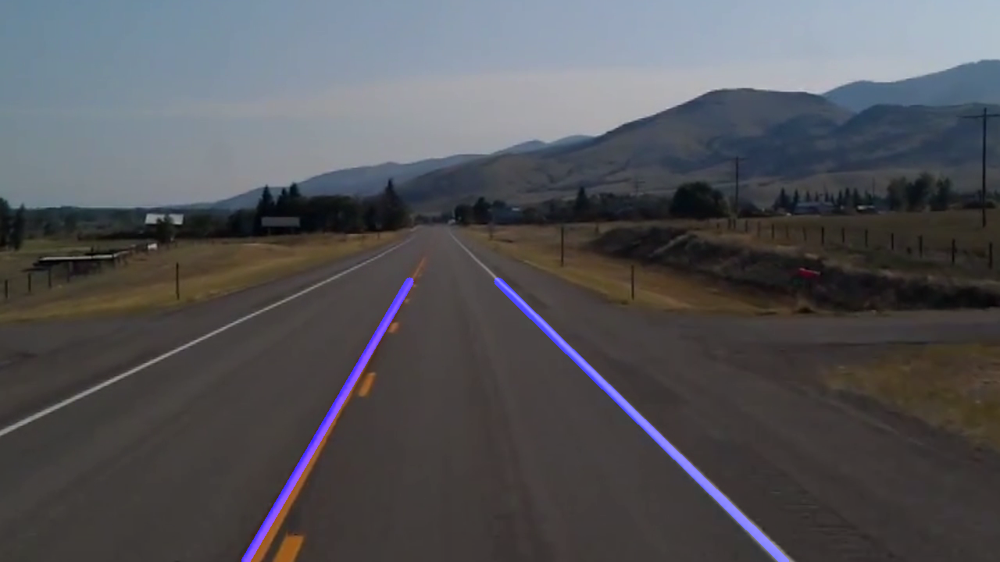

Frame No. [[[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [254 234 210]
  [254 234 210]
  [254 234 210]]

 [[192 164 130]
  [192 164 130]
  [192 164 130]
  ...
  [254 234 210]
  [254 234 210]
  [254 234 210]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [255 234 213]
  [255 234 213]
  [255 234 213]]

 ...

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  67  72]
  [ 64  67  72]
  [ 64  67  72]]

 [[ 67  70  75]
  [ 67  70  75]
  [ 67  70  75]
  ...
  [ 63  66  71]
  [ 63  66  71]
  [ 64  67  72]]

 [[ 68  71  76]
  [ 68  71  76]
  [ 68  71  76]
  ...
  [ 63  66  71]
  [ 63  66  71]
  [ 63  66  71]]]
Left [  -1.78768698 1297.74624442]
Right [   0.97045858 -259.51461719]


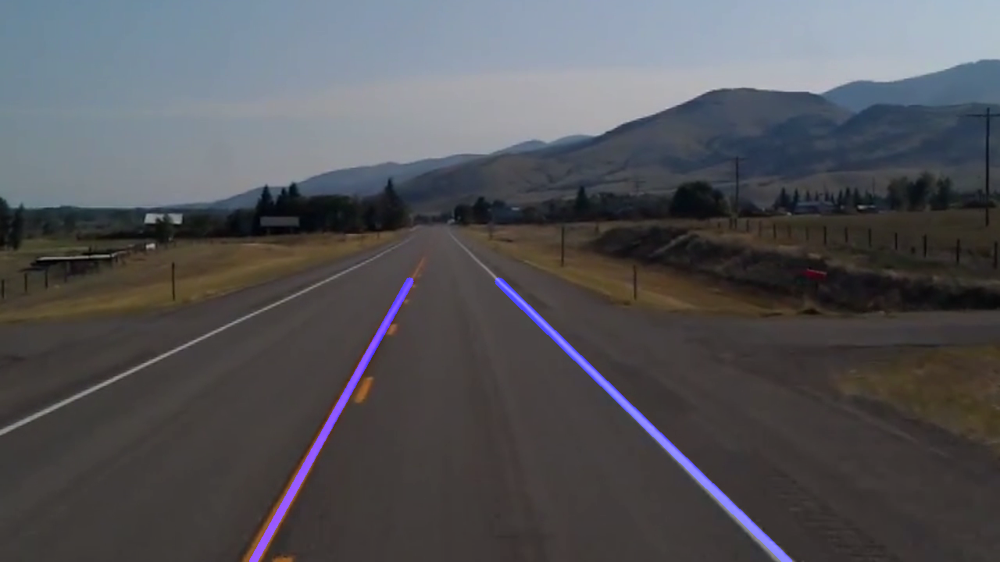

Frame No. [[[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [250 235 210]
  [250 235 210]
  [250 235 210]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [250 235 210]
  [250 235 210]
  [250 235 210]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [251 236 211]
  [251 236 211]
  [251 236 211]]

 ...

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  66  73]
  [ 63  65  72]
  [ 63  65  72]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  66  73]
  [ 63  65  72]
  [ 63  65  72]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  66  73]
  [ 63  65  72]
  [ 63  65  72]]]
Left [  -1.75782748 1281.09277775]
Right [   0.97979504 -266.38000856]


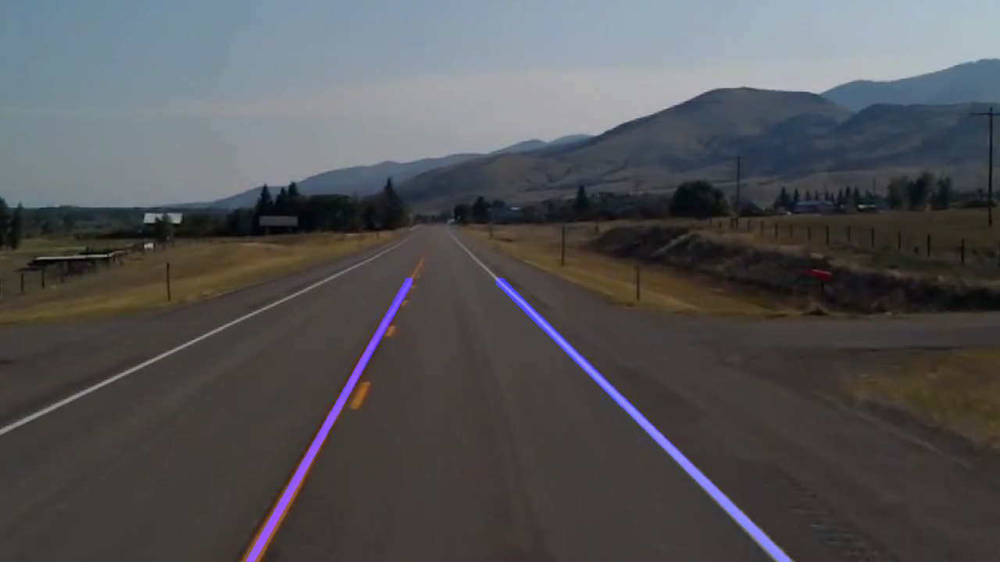

Frame No. [[[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [250 235 210]
  [250 235 210]
  [250 235 210]]

 [[190 164 130]
  [190 164 130]
  [190 164 130]
  ...
  [250 235 210]
  [250 235 210]
  [250 235 210]]

 [[188 165 130]
  [188 165 130]
  [188 165 130]
  ...
  [251 236 211]
  [251 236 211]
  [251 236 211]]

 ...

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  66  73]
  [ 63  65  72]
  [ 63  65  72]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  66  73]
  [ 63  65  72]
  [ 63  65  72]]

 [[ 66  69  74]
  [ 66  69  74]
  [ 66  69  74]
  ...
  [ 64  66  73]
  [ 63  65  72]
  [ 63  65  72]]]
Left [  -1.75782748 1281.09277775]
Right [   0.97979504 -266.38000856]


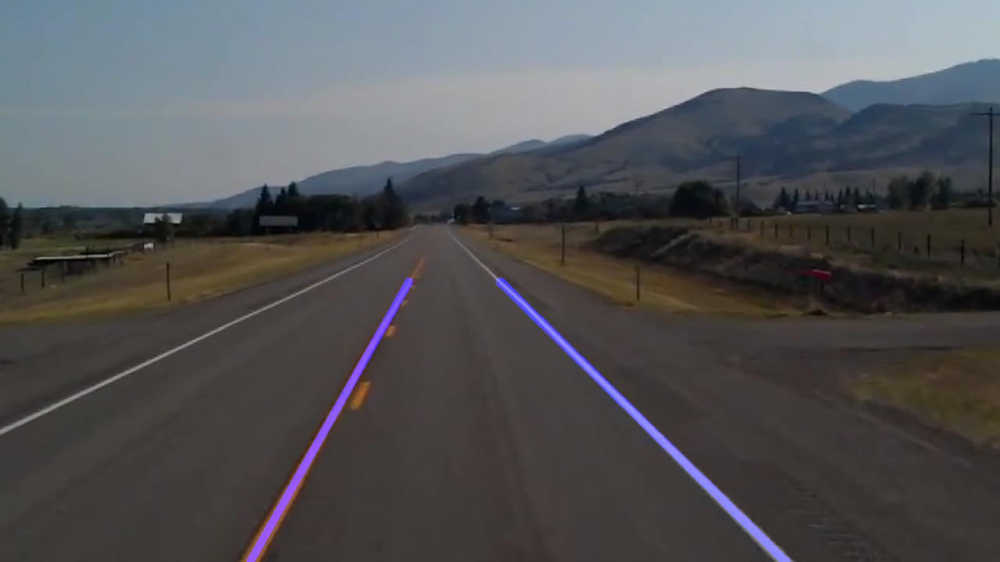

Frame No. [[[190 164 130]
  [190 164 130]
  [190 164 132]
  ...
  [245 233 211]
  [245 233 211]
  [245 233 211]]

 [[190 164 130]
  [190 164 130]
  [190 164 132]
  ...
  [245 233 211]
  [245 233 211]
  [245 233 211]]

 [[188 165 132]
  [188 165 132]
  [188 165 132]
  ...
  [246 234 212]
  [246 234 212]
  [246 234 212]]

 ...

 [[ 63  71  75]
  [ 62  70  74]
  [ 64  70  74]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 63  71  75]
  [ 62  70  74]
  [ 64  70  74]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]

 [[ 63  71  75]
  [ 62  70  74]
  [ 64  70  74]
  ...
  [ 67  69  76]
  [ 67  69  76]
  [ 67  69  76]]]
Left [  -1.76112758 1277.01382447]
Right [   0.98496567 -269.67115842]


In [ ]:
from google.colab.patches import cv2_imshow
cap = cv2.VideoCapture('/content/gdrive/MyDrive/Kaggle/newDataset/test_video.mp4') 
while (cap.isOpened):
     _, frame = cap.read() 
     print("Frame No.", frame)
     lane_image = np.copy(frame)
     gray = cv2.cvtColor(lane_image,cv2.COLOR_RGB2GRAY)
     blur = cv2.GaussianBlur(gray,(5,5),0)
     canny_image = cv2.Canny(blur, 50, 150) 
     mask = region_of_interest(canny_image)
     cropped_image = canny_image & mask
     lines = cv2.HoughLinesP(cropped_image, rho = 2,theta= np.pi/180, threshold = 100, lines = np.array([]),
                            minLineLength = 40, maxLineGap = 5)
     line_image = display_line(lane_image, lines)
     avg_lines = average_line(lane_image, lines)
     line_image= display_line(lane_image, avg_lines)
     combo_image = cv2.addWeighted(lane_image, 0.8, line_image, 1, 1) 
     cv2_imshow(combo_image)
     cv2.waitKey(1)
    